In [13]:
import os 
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

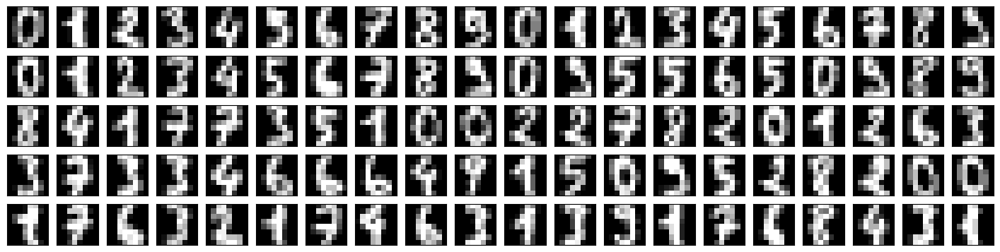

In [14]:
from sklearn.datasets import load_digits
digits = load_digits()
X = (digits.data[:1000] / 16)
y = digits.target[:1000]
plt.rcParams["figure.figsize"] = (18,18)
plt.gray() 
for i in range(100):
    plt.subplot(20, 20, i + 1)
    plt.imshow(digits.images[i], cmap=plt.cm.gray, vmax=16, interpolation='nearest')
    plt.xticks(())
    plt.yticks(())
plt.show()
# print(len(X))
# for data , label in zip(digits.data/16 , digits.target) : 
#     print(f"Data : {data} , Label : {label}")

In [15]:
def EuclideanDistance(X) : 
    D = [[0.0]*len(X) for _ in range(len(X))]
    for i in range(len(X)) : 
        for j in range(len(X)) : 
            distance = 0.0
            for idx in range(len(X[i])) : 
                distance += (X[i][idx]-X[j][idx])**2
            D[i][j] = distance**(1/2)
    return D   

In [16]:
import math
def BinarySearchPropability(DistanceMap , Perplexity , step) : 
    P = [[0.0]*len(DistanceMap) for _ in range(len(DistanceMap))]
    DesiredEntropy = math.log(Perplexity)
    # print(len(DistanceMap))
    for row_idx , Di in enumerate(DistanceMap) : 
        # print(f"epoch : {row_idx}")
        Beta = 1.0
        Beta_MaxLimit = float('INF')
        Beta_MinLimit = float('INF')*-1
        for s in range(step) :
            summationPi = 0.0
            for col_idx , Dij in enumerate(Di) : 
                Pij = math.exp(-Dij*Beta)
                P[row_idx][col_idx] = Pij
                summationPi += Pij
            Summation_DistancePropablity = 0.0
            for Pij in P[row_idx] : 
                Pij = Pij/summationPi
            for j in range(len(P[row_idx])) : 
                Summation_DistancePropablity += P[row_idx][j]*DistanceMap[row_idx][j]
            Entropy = math.log(summationPi)+Beta*Summation_DistancePropablity
            # print(f"summationPi : {summationPi}    Pi : {P[row_idx]}")
            # print(f"Summation_DistancePropablity : {Summation_DistancePropablity}   Entropy : {Entropy}")
            if abs(Entropy - DesiredEntropy) < 0.0003 : 
                break
            if Entropy > DesiredEntropy : 
                Beta_MinLimit = Beta
                if Beta_MaxLimit == float('INF') : 
                    Beta *= 2.0
                else : 
                    Beta = (Beta_MaxLimit-Beta)/2.0
            if Entropy < DesiredEntropy : 
                Beta_MaxLimit = Beta
                if Beta_MinLimit == float('INF') : 
                    Beta /= 2.0
                else : 
                    Beta = (Beta-Beta_MinLimit)/2.0
        # input()
    return P

def Convert_PropabilitySymatricMatrix(matrix) : 
    matrix_T = matrix.copy()
    for i in range(len(matrix)) : 
        for j in range(len(matrix[i])) : 
            for x in range(len(matrix[i])) : 
                matrix[i][x] = matrix[i][x] + matrix_T[x][j]
                matrix[i][x] /= (2*len(matrix))
    return matrix

def DimensionReuctData_Propability(Y) : 
    Y_DistanceMap = EuclideanDistance(Y)
    Q = [[0.0]*len(Y) for _ in range(len(Y))]
    for i in range(len(Q)) : 
        summation_Qi = 0.0
        for j in range(len(Q[i])) : 
            Q[i][j] = (1+Y_DistanceMap[i][j]**2)**(-1)
            summation_Qi += Q[i][j]
        for j in range(len(Q[i])) : 
            Q[i][j] = Q[i][j] / summation_Qi
    return Q

# P = BinarySearchPropability(DistanceMap , 30 , 30)
# print(P)

In [17]:
import numpy as np
def PCA(X , components) : 
    """將X進行SVD分解 得出矩陣 U W sigma"""
    X_center = X-np.mean(X , axis=0)
    W , D , V = np.linalg.svd(X_center.T)
    """W is EigenVector Matrix"""
    RedudctionEigenMatrix = W[:,0:components]
    Y = [[0.0]*components for _ in range(len(X))]
    for n in range(len(X)) : 
        for m in range(len(RedudctionEigenMatrix[0])) : 
            results = 0.0
            for l in range(len(X[n])) : 
                results += X[n][l]*RedudctionEigenMatrix[l][m]
            Y[n][m] = results
    return Y 

In [18]:
def KL_Divergences(P , Q , Y) : 
    GradMap = [[0.0]*len(Y[0]) for _ in range(len(Y))]
    for i in range(len(Y)) : 
        for j in range(len(Y[i])) :
            Distance_ij = [[0.0] for _ in range(len(Y[i]))]
            """create a vector"""
            for x in range(len(Y[i])) : 
                Distance_ij[x] = Y[i][x]-Y[j][x]
            """Yi-Yj"""
            EuclideanDistance_ij = 0.0
            for x in range(len(Distance_ij)) : 
                EuclideanDistance_ij += Distance_ij[x]**2
            """||Yi-Yj||**2"""
            for x in range(len(Distance_ij)) :
                GradMap[i][x] = 4*(P[i][j] - Q[i][j])*(Distance_ij[x])*(1+EuclideanDistance_ij)**(-1)
            """grad = 4*summation{ (Pij-Qij)  *  (Yi-Yj)  *  ((1+||Yi-Yj||**2)**-1) }"""
            # grad += 4*(P[i][j] - Q[i][j])*(Distance_ij)*(1+EuclideanDistance_ij)**(-1)
    return GradMap

In [19]:
def GradientDescent(P , Q , Y , MaxIter , GradMap , learning_rate , momentum) : 
    gradmap = GradMap.copy()
    Yt = Y.copy()
    Yt_1 = Y.copy()
    Yt_2 = Y.copy()
    for turn in range(MaxIter) : 
        print(f"epoch : {turn}")
        gradmap = LearningRate_GradMap(learning_rate , gradmap)
        if turn < 1 : 
            for i in range(len(Yt)) : 
                for j in range(len(Yt[i])) : 
                    Yt[i][j] += gradmap[i][j]
            # Yt = Yt_1 + gradmap
        else : 
            MomentumFunciton = Momentum_Yt1_Yt2(momentum , Yt_1 , Yt_2)
            for i in range(len(Yt)) : 
                for j in range(len(Yt[i])) : 
                    Yt[i][j] += (gradmap[i][j]+MomentumFunciton[i][j])
            # Yt = Yt_1 - gradmap + momentum*(Yt_1-Yt_2)
        Yt_1 = Yt.copy()
        Yt_2 = Yt_1.copy()
        gradmap = KL_Divergences(P , Q , Y)
        print(Yt)
    return Yt

def LearningRate_GradMap(learning_rate , gradmap) : 
    temp = gradmap.copy()
    for i in range(len(gradmap)) : 
        for j in range(len(gradmap[i])) : 
            temp[i][j] = learning_rate*gradmap[i][j]
    return temp

def Momentum_Yt1_Yt2(momentum , Yt_1 , Yt_2) : 
    temp = [[0.0] * len(Yt_1) for _ in range(len(Yt_1))]
    for i in range(len(Yt_1)) : 
        for j in range(len(Yt_1[i])) : 
            temp[i][j] = momentum*(Yt_1[i][j]-Yt_2[i][j])
    return temp

In [20]:
DistanceMap = EuclideanDistance(X)

P = BinarySearchPropability(DistanceMap , 30 , 700)

Y = PCA(X , components=2)
Q = DimensionReuctData_Propability(Y)

# for i in Y : 
#     print(i)
# for i in Q : 
#     print(i)

GradMap = KL_Divergences(P , Q , Y)
learning_rate = 200
momentum = 0.2
MaxIter = 1000
Y = GradientDescent(P , Q , Y , MaxIter , GradMap , learning_rate , momentum)

epoch : 0
[[2.5949876004934858, -1.471035942451901], [-0.9869689404579041, 0.2535217084950777], [5.967388403223513, -5.701513975992887], [8.044569885680808, 0.9361303165502544], [-1.6603915479077158, -7.683350675277813], [7.246885008030326, 1.0907726734096597], [3.4170787207541187, -12.047018195456943], [-0.7182349937374496, 5.943554874109958], [6.637648851264013, -1.0422651235360751], [4.746451591751322, -0.41663958003316354], [2.0560236990835703, -3.81911680943102], [-5.375519843161397, 18.26653281822524], [8.320885665006516, -3.067088404936768], [6.150438461697375, 4.387442738560824], [-4.820850621863155, -8.625700904140839], [7.107205267645485, 0.356467429940628], [3.941982490993528, -12.24820670546475], [-2.464975078050164, 4.629857892589871], [7.0424260158331435, 4.109819205863016], [4.7819365714739455, -0.15147750541080346], [2.5684157009772677, -2.899677243913092], [0.7262273313070409, 23.542235715227452], [10.08940313609131, -1.464493004067829], [3.474466653646849, 4.115665228

1000


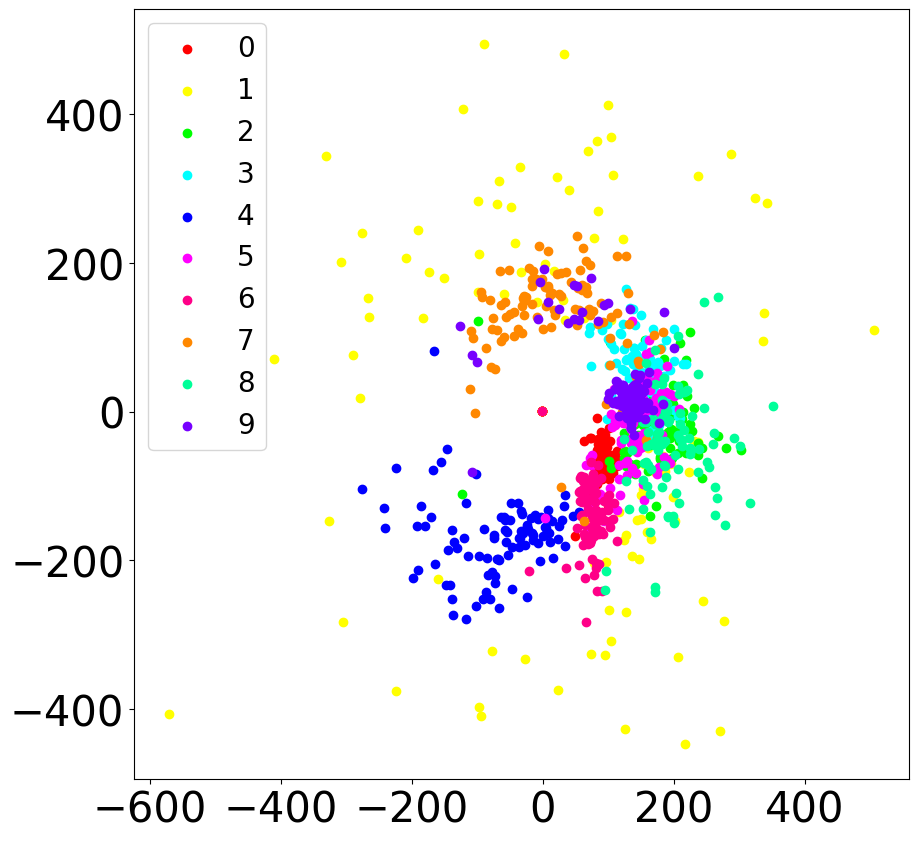

In [21]:
X_sub = np.array(Y)
color=["#FF0000","#FFFF00","#00FF00","#00FFFF","#0000FF",
       "#FF00FF","#FF0088","#FF8800","#00FF99","#7700FF"]
plt.rcParams["figure.figsize"] = (10,10)
print(len(y))
for i in range(0,10):
    BOOL=(y==i)
    plt.scatter(X_sub[BOOL,0],X_sub[BOOL,1],c=color[i],label=i)
plt.xticks(fontsize=30)
plt.yticks(fontsize=30)
plt.legend(fontsize=20)
plt.show()